In [2]:
import numpy as np
import matplotlib.pyplot as plt
import random
import json
import pandas
import math
from tqdm import tqdm
import collections
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.stattools import kpss

# Social dilemma class

In [3]:
class social_dilemma(object):
    def __init__(self, pd=[3, 1, 0, 4], sh=[5, 2, 0, 4], ch=[3, 0, 1, 4], bs=[2, 0, 0, 1],
                 dilemma_type="pd", steps_number=1, noise_prob=0):
        self.steps_number = steps_number
        self.states = np.arange(steps_number)
        self.actions = [0, 1]
        self.curr_state = 0
        self.dilemma_type = dilemma_type
        self.pd = pd
        self.sh = sh
        self.ch = ch
        self.bs = bs
        if self.dilemma_type == "pd":
            self.main_rew_f = self.pd_rew
            self.other_rew_f1 = self.sh_rew
            self.other_rew_f2 = self.ch_rew
            self.other_rew_f3 = self.bs_rew
        if self.dilemma_type == "sh":
            self.main_rew_f = self.sh_rew
            self.other_rew_f1 = self.pd_rew
            self.other_rew_f2 = self.ch_rew
            self.other_rew_f3 = self.bs_rew
        if self.dilemma_type == "ch":
            self.main_rew_f = self.ch_rew
            self.other_rew_f1 = self.pd_rew
            self.other_rew_f2 = self.sh_rew
            self.other_rew_f3 = self.bs_rew
        if self.dilemma_type == "bs":
            self.main_rew_f = self.bs_rew
            self.other_rew_f1 = self.pd_rew
            self.other_rew_f2 = self.sh_rew
            self.other_rew_f3 = self.ch_rew
        if self.dilemma_type == "hs":
            self.main_rew_f = self.hs_rew
        if self.dilemma_type == "sp":
            self.main_rew_f = self.sp_rew
        if self.dilemma_type == "wmp":
            self.main_rew_f = self.wmp_rew
        self.noise_prob = noise_prob
    def action(self):
        self.curr_state += 1
        return self.curr_state
    def reset(self):
          self.curr_state = 0
    def pd_rew(self, your_act, opponent_act, player):
        if (your_act == 1 and opponent_act == 1):
            reward = self.pd[0]
        if (your_act == 0 and opponent_act == 1):
            reward = self.pd[3]
        if (your_act == 1 and opponent_act == 0):
            reward = self.pd[2]
        if (your_act == 0 and opponent_act == 0):
            reward = self.pd[1]
        return reward
    def sh_rew(self, your_act, opponent_act, player):
        if (your_act == 1 and opponent_act == 1):
            reward = self.sh[0]
        if (your_act == 0 and opponent_act == 1):
            reward = self.sh[3]
        if (your_act == 1 and opponent_act == 0):
            reward = self.sh[2]
        if (your_act == 0 and opponent_act == 0):
            reward = self.sh[1]
        return reward
    def ch_rew(self, your_act, opponent_act, player):
        if (your_act == 1 and opponent_act == 1):
            reward = self.ch[0]
        if (your_act == 0 and opponent_act == 1):
            reward = self.ch[3]
        if (your_act == 1 and opponent_act == 0):
            reward = self.ch[2]
        if (your_act == 0 and opponent_act == 0):
            reward = self.ch[1]
        return reward
    def bs_rew(self, your_act, opponent_act, player):
        if (player == 0):
            if (your_act == 1 and opponent_act == 1):
                reward = self.bs[0]
            if (your_act == 0 and opponent_act == 1):
                reward = self.bs[1]
            if (your_act == 1 and opponent_act == 0):
                reward = self.bs[2]
            if (your_act == 0 and opponent_act == 0):
                reward = self.bs[3]
        if (player == 1):
            if (your_act == 1 and opponent_act == 1):
                reward = self.bs[3]
            if (your_act == 0 and opponent_act == 1):
                reward = self.bs[2]
            if (your_act == 1 and opponent_act == 0):
                reward = self.bs[1]
            if (your_act == 0 and opponent_act == 0):
                reward = self.bs[0]
        return reward
    
    def hs_rew(self, your_act, opponent_act, player):
        if (player == 0):
            if (your_act == 1 and opponent_act == 1):
                reward = 0
            if (your_act == 0 and opponent_act == 1):
                reward = 1
            if (your_act == 1 and opponent_act == 0):
                reward = 1
            if (your_act == 0 and opponent_act == 0):
                reward = 0
        if (player == 1):
            if (your_act == 1 and opponent_act == 1):
                reward = 1
            if (your_act == 0 and opponent_act == 1):
                reward = 0
            if (your_act == 1 and opponent_act == 0):
                reward = 0
            if (your_act == 0 and opponent_act == 0):
                reward = 1
        return reward
    def sp_rew(self, your_act, opponent_act, player):
        if (player == 0):
            if (your_act == 1 and opponent_act == 1):
                reward = 1
            if (your_act == 0 and opponent_act == 1):
                reward = 0
            if (your_act == 1 and opponent_act == 0):
                reward = 0
            if (your_act == 0 and opponent_act == 0):
                reward = 2
        if (player == 1):
            if (your_act == 1 and opponent_act == 1):
                reward = 2
            if (your_act == 0 and opponent_act == 1):
                reward = 3
            if (your_act == 1 and opponent_act == 0):
                reward = 1
            if (your_act == 0 and opponent_act == 0):
                reward = 0
        return reward
    def wmp_rew(self, your_act, opponent_act, player):
        if (player == 0):
            if (your_act == 1 and opponent_act == 1):
                reward = 3
            if (your_act == 0 and opponent_act == 1):
                reward = -1
            if (your_act == 1 and opponent_act == 0):
                reward = -2
            if (your_act == 0 and opponent_act == 0):
                reward = 0
        if (player == 1):
            if (your_act == 1 and opponent_act == 1):
                reward = -3
            if (your_act == 0 and opponent_act == 1):
                reward = 2
            if (your_act == 1 and opponent_act == 0):
                reward = 1
            if (your_act == 0 and opponent_act == 0):
                reward = 0
        return reward
    
    def reward_func(self, your_act, opponent_act, player, noise_prob=0):
        err = 0
        
        reward = self.main_rew_f(your_act, opponent_act, player)
        has_noise = np.random.choice([True, False], p = [noise_prob, 1 - noise_prob])
        
        if has_noise:
            err = 1
#             rew_f = np.random.choice([self.other_rew_f1, self.other_rew_f2, self.other_rew_f3])
#             reward =  rew_f(your_act, opponent_act, player)
                
        return reward, err
    def play(self, choice_func):
        p1_act = choice_func(self.actions)
        p2_act = choice_func(self.actions)
        p1_rew = self.reward_func(p1_act, p2_act, 0)
        p2_rew = self.reward_func(p2_act, p1_act, 1)
        return [p1_act, p2_act, p1_rew, p2_rew]

# Q-Learning

In [4]:
def calc_q(game,  Q, curr_state, next_state, your_act, enemy_act, alpha, gamma, player, noise_prob, prob):
#     if next_state < len(game.states) - 1:
#         next_q = np.max(Q[curr_state])
#     else: 
#         next_q = 0
    next_q = np.max(Q[curr_state])

    reward, err = game.reward_func(your_act, enemy_act, player, noise_prob)
    res = Q[curr_state, your_act] + alpha * (reward + gamma * next_q - Q[curr_state, your_act])
    # res = Q[curr_state, your_act] + (1/prob) * alpha * (reward + gamma * next_q - Q[curr_state, your_act])
    return res, reward, err

In [5]:
def sd_qlearning(game, episode_count=100, alpha=0.5, gamma=0.5, eps = 0.1, beta=1, noise_prob=0):
    policy1 = [] #shape: session-step-action
    policy2 = []

    payoff1 = [[] for _ in range(len(game.states))]
    payoff2 = [[] for _ in range(len(game.states))]
    
    history = [[] for _ in range(len(game.states))]
    history_rew = [[] for _ in range(len(game.states))]
    history_Q1 = [[] for _ in range(len(game.states))]
    history_Q2 = [[] for _ in range(len(game.states))]

    
    errs = [0] * len(game.states)

    Q1 = np.zeros([len(game.states), len(game.actions)]) 
    Q2 = np.zeros([len(game.states), len(game.actions)]) 
    
    terminal_state = len(game.states) - 1

    for i in range(episode_count):
        p1_s = 0
        p2_s = 0

        j = 0
        
        while game.curr_state <= terminal_state:  
            # use eps-greedy policy
            # p1_a = np.random.choice([np.argmax(Q1[p1_s]), np.random.choice(game.actions)], p = [1-eps, eps])
            # p2_a = np.random.choice([np.argmax(Q2[p2_s]), np.random.choice(game.actions)], p = [1-eps, eps])
            
            # use softmax policy
            if (len(policy1) > 0):
                if math.isnan(policy1[-1][game.curr_state][0]):
                    policy1[-1][game.curr_state][0] = 0.99999999999999
                    policy1[-1][game.curr_state][1] = 1.0 - 0.99999999999999
                if math.isnan(policy1[-1][game.curr_state][1]):
                    policy1[-1][game.curr_state][1] = 0.99999999999999
                    policy1[-1][game.curr_state][0] = 1.0 - 0.99999999999999
                if math.isnan(policy2[-1][game.curr_state][0]):
                    policy2[-1][game.curr_state][0] = 0.99999999999999
                    policy2[-1][game.curr_state][1] = 1.0 - 0.99999999999999
                if math.isnan(policy2[-1][game.curr_state][1]):
                    policy2[-1][game.curr_state][1] = 0.99999999999999
                    policy2[-1][game.curr_state][0] = 1.0 - 0.99999999999999
                
                p1_a = np.random.choice([0, 1], p = [policy1[-1][game.curr_state][0], policy1[-1][game.curr_state][1]])
                p2_a = np.random.choice([0, 1], p = [policy2[-1][game.curr_state][0], policy2[-1][game.curr_state][1]])
            else:
                p1_a = np.random.choice([1, 0])
                p2_a = np.random.choice([1, 0])

            # making step
            game.action()
            p1_s1 = game.curr_state
            p2_s1 = game.curr_state
            
            if len(policy1) == 0:
                p1p = 0.5
                p2p = 0.5
            else:
                if p1_a == 0:
                    p1p = policy1[-1][0][0]
                else:
                    p1p = policy1[-1][0][1]

                if p2_a == 0:
                    p2p = policy2[-1][0][0]
                else:
                    p2p = policy2[-1][0][1]

            #calc Q
            Q1[p1_s, p1_a], rew1, err1 = calc_q(game, Q1, p1_s, p1_s1, p1_a, p2_a, alpha, gamma, 0, noise_prob, p1p)
            Q2[p2_s, p2_a], rew2, err2 = calc_q(game, Q2, p2_s, p2_s1, p2_a, p1_a, alpha, gamma, 1, noise_prob, p2p)
            
            errs[j] += max(err1, err2)
            
            #change payoff
            step_payoff1 = np.matrix([[np.nan] * 2] * 2)
            step_payoff2 = np.matrix([[np.nan] * 2] * 2)
            step_payoff1[p1_a, p2_a] = rew1
            step_payoff2[p2_a, p1_a] = rew2
            
            payoff1[j].append(step_payoff1)
            payoff2[j].append(step_payoff2)
            
            history[j].append([p1_a, p2_a])
            history_rew[j].append([rew1, rew2])
            history_Q1[j].append(Q1[j].copy())
            history_Q2[j].append(Q2[j].copy())

            # change state
            p1_s = p1_s1
            p2_s = p2_s1
            
            j += 1
        
        # calc softmax policy
        session1 = []
        session2 = []
        for j in range(len(game.states)):
            pol1 = [None] * 2
            pol2 = [None] * 2
            pol1[0] = np.exp(beta * Q1[j][0]) / (np.exp(beta * Q1[j][0]) + np.exp(beta * Q1[j][1]))
            pol1[1] = np.exp(beta * Q1[j][1]) / (np.exp(beta * Q1[j][0]) + np.exp(beta * Q1[j][1]))
            pol2[0] = np.exp(beta * Q2[j][0]) / (np.exp(beta * Q2[j][0]) + np.exp(beta * Q2[j][1]))
            pol2[1] = np.exp(beta * Q2[j][1]) / (np.exp(beta * Q2[j][0]) + np.exp(beta * Q2[j][1]))

            session1.append(pol1)
            session2.append(pol2)

        policy1.append(session1)
        policy2.append(session2)
        
        # reset the game after the last state
        game.reset()
      
    payoff_matrixes1 = [np.nanmean(x, axis=0) for x in payoff1]
    payoff_matrixes2 = [np.nanmean(x, axis=0) for x in payoff2]

#     errs = errs / (episode_count * len(game.states))
    errs = np.array(errs) / episode_count
    
    # print(policy1)
    # print(len(policy2))
    return policy1, policy2, payoff_matrixes1, payoff_matrixes2, errs, history, history_Q1, history_Q2, history_rew

# Analizing functions

## check

In [6]:
def if_pd(payoff_matrix1, payoff_matrix2, step):
    return (payoff_matrix1[step][0][0] > payoff_matrix1[step][1][0] and
                payoff_matrix1[step][1][1] > payoff_matrix1[step][0][0] and
                payoff_matrix1[step][0][1] > payoff_matrix1[step][1][1]) and (payoff_matrix2[step][0][0] > 
                                                                              payoff_matrix2[step][1][0] and
                payoff_matrix2[step][1][1] > payoff_matrix2[step][0][0] and
                payoff_matrix2[step][0][1] > payoff_matrix2[step][1][1])

In [7]:
def if_sh(payoff_matrix1, payoff_matrix2, step):
    return (payoff_matrix1[step][0][0] > payoff_matrix1[step][1][0] and
                payoff_matrix1[step][0][1] > payoff_matrix1[step][0][0] and
                payoff_matrix1[step][1][1] > payoff_matrix1[step][0][1]) and (payoff_matrix2[step][0][0] > 
                                                                              payoff_matrix2[step][1][0] and
                payoff_matrix2[step][0][1] > payoff_matrix2[step][0][0] and
                payoff_matrix2[step][1][1] > payoff_matrix2[step][0][1])

In [8]:
def if_bs(payoff_matrix1, payoff_matrix2, step):
    return (payoff_matrix1[step][1][1] > payoff_matrix1[step][0][0] and
                payoff_matrix1[step][0][0] > payoff_matrix1[step][1][0] and
                payoff_matrix1[step][0][0] > payoff_matrix1[step][0][1]) and (payoff_matrix2[step][0][0] > 
                                                                              payoff_matrix2[step][1][1] and
                payoff_matrix2[step][1][1] > payoff_matrix2[step][1][0] and
                payoff_matrix2[step][1][1] > payoff_matrix2[step][0][1])

In [9]:
def cc_check(pol1, pol2, epsilon=0.01, delta=0.7, episode_count=100000):
    return len([elem for elem in pol1 if elem > (1 - epsilon)]) > episode_count * delta and len(
                    [elem for elem in pol2 if elem > (1 - epsilon)]) > episode_count * delta

In [10]:
def dd_check(pol1, pol2, epsilon=0.01, delta=0.7, episode_count=100000):
    return len([elem for elem in pol1 if elem < epsilon]) > episode_count * delta and len(
                    [elem for elem in pol2 if elem < epsilon]) > episode_count * delta

In [11]:
# def cd_dc_check(pol1, pol2, step, epsilon, delta, episode_count):
#     return (len([elem for elem in pol1[step] if elem[1] > (1 - epsilon)]) > episode_count * delta and len(
#                     [elem for elem in pol2[step] if elem[0] > (1 - epsilon)]) > episode_count * delta) or (len(
#                     [elem for elem in pol1[step] if elem[0] > (1 - epsilon)]) > episode_count * delta and len(
#                     [elem for elem in pol2[step] if elem[1] > (1 - epsilon)]) > episode_count * delta)
                    
def cd_dc_check(pol1, pol2, epsilon=0.01, delta=0.7, episode_count=100000):
    return (len([elem for elem in pol1 if elem > (1 - epsilon)]) > episode_count * delta and len(
                    [elem for elem in pol2 if 1 - elem > (1 - epsilon)]) > episode_count * delta) or (len(
                    [elem for elem in pol1 if 1 - elem > (1 - epsilon)]) > episode_count * delta and len(
                    [elem for elem in pol2 if elem > (1 - epsilon)]) > episode_count * delta)

In [12]:
def mixed_equilibria_check(payoff_matrix, pol1, pol2, step, epsilon, delta, episode_count):
    eq = (payoff_matrix[0] - payoff_matrix[3]) / (payoff_matrix[0] - payoff_matrix[3] + payoff_matrix[1] - payoff_matrix[2])
    return (len([elem for elem in pol1[step] if elem[1] > (eq - epsilon) or elem[1] < (eq + epsilon)]) > episode_count * delta 
            and len([elem for elem in pol2[step] if elem[0] > (eq - epsilon) or elem[0] < (eq + epsilon)])
            > episode_count * delta) or (len([elem for elem in pol1[step] if elem[0] > (eq - epsilon) or elem[0]
                                              < (eq + epsilon)]) > episode_count * delta
            and len([elem for elem in pol2[step] if elem[1] > (eq - epsilon) or elem[1] < (eq + epsilon)])
                                         > episode_count * delta)

In [13]:
class NpEncoder(json.JSONEncoder):
    def default(self, obj):
        if isinstance(obj, np.integer):
            return int(obj)
        if isinstance(obj, np.floating):
            return float(obj)
        if isinstance(obj, np.ndarray):
            return obj.tolist()
        return json.JSONEncoder.default(self, obj)

# Experiments

In [14]:
def simulate(pd = [3, 1, 0, 4], time=100000, gamma=0.9, alpha=0.01, beta=1, show_q=False, show_plots=True):
    n_step_pd = social_dilemma(pd=pd,  dilemma_type="pd", steps_number=1)
    pol1, pol2, payoff_matrix1, payoff_matrix2, errs, history, Q1, Q2, h_rew = sd_qlearning(n_step_pd, time, gamma=gamma, alpha=alpha, beta=beta, noise_prob=0)

    pol1 = np.moveaxis(pol1, 0, 1)
    pol2 = np.moveaxis(pol2, 0, 1)
    
    pol1_y1 = [row[1] for row in pol1[0]]
    pol2_y1 = [row[1] for row in pol2[0]]

    q1c = [row[1] for row in Q1[0]]
    q1d = [row[0] for row in Q1[0]]

    q2c = [row[1] for row in Q2[0]]
    q2d = [row[0] for row in Q2[0]]
    
    if show_plots:
        plt.plot(pol1_y1)
        plt.plot(pol2_y1)
        plt.show()
        
        if show_q:
            plt.plot(q1c, label="q1c")
            plt.plot(q1d, label="q1d")
            plt.show()
            
            plt.plot(q2c, label="q2c")
            plt.plot(q2d, label="q2d")
            plt.show()
    return pol1_y1, pol2_y1, q1c, q1d, q2c, q2d, history[0], h_rew[0]

# Prisoners dilemma

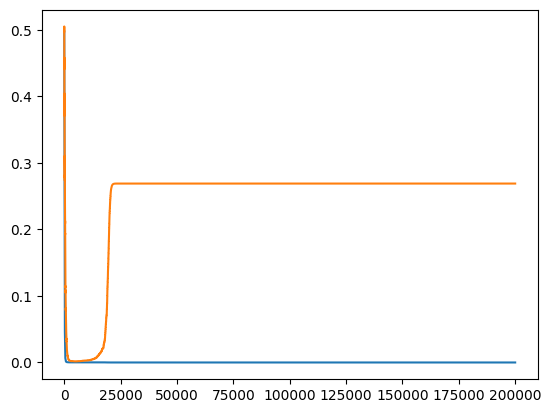

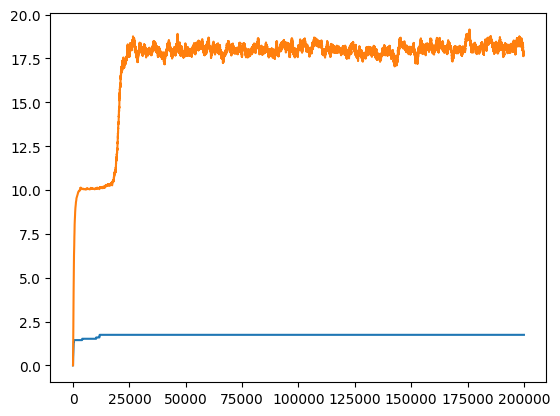

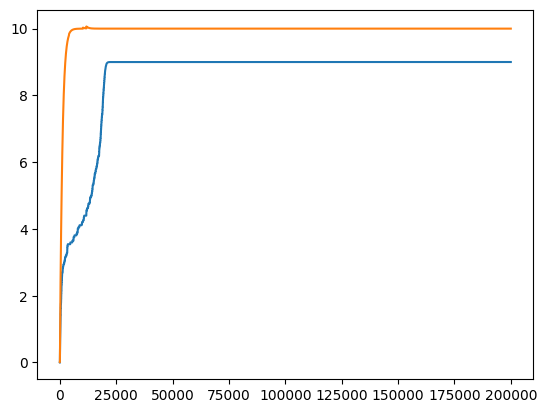

{"prob_c_player1": [0.49750002083312506, 0.4875051019542527, 0.49511513292535225, 0.49262800925639694, 0.4926867368361024, 0.4902024545189467, 0.4802289844156792, 0.4803990810792864, 0.4779308320047002, 0.4679902471400444, 0.45808490603425317, 0.44822244084510965, 0.4384103345425123, 0.4389513677500028, 0.42919409443292694, 0.42981468186096605, 0.4201181046796414, 0.4177710510093089, 0.4184890882900319, 0.426521625545721, 0.4168570172181882, 0.4145271173649849, 0.41220335899632154, 0.42025116716803523, 0.41064113850298845, 0.40110833400069534, 0.3916591867332957, 0.38940884228296213, 0.3975091059863962, 0.39837248429141664, 0.396110944670016, 0.39698500972155715, 0.4050594993299714, 0.4058501655366265, 0.4138916726678324, 0.41160459345565853, 0.41961929228818123, 0.42759584784109783, 0.41797468782002484, 0.4084250737706088, 0.4091627376033285, 0.3996856506694122, 0.40771989944913106, 0.4054740911743282, 0.4062278422378127, 0.4142345955850219, 0.41490533341854496, 0.41556967471313605, 0

In [16]:
beta = 1
gamma = 0.9
beta_str = str(beta).replace(".", "_")
gamma_str = str(gamma).replace(".", "_") 

pol1_y1, pol2_y1, q1c, q1d, q2c, q2d, h_act, h_rew = simulate(pd = [3, 1, 0, 4], time = 200000, gamma=gamma, beta=beta, alpha=0.01, show_q=True)

data = {
    'prob_c_player1': pol1_y1,
    'prob_c_player2': pol2_y1,
    'Q-val_player1_act_c': q1c,
    'Q-val_player1_act_d': q1d,
    'Q-val_player2_act_c': q2c,
    'Q-val_player2_act_d': q2d
}
json_string = json.dumps(data, cls=NpEncoder)
print(json_string)
